# Deconvolute the CRC stereo-seq data (Fig 4c-h)

In [114]:
import warnings
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import smoother
from smoother import SpatialWeightMatrix, SpatialLoss
from smoother.models.deconv import LinearRegression, NNLS, NuSVR, DWLS, LogNormReg
from smoother.visualization import *
from plotnine import *
from plotnine_prism import *

Plotting function for publication:

In [115]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
from plotnine import *


def plot_celltype_props_pub(p_inf, coords, cell_type_names = None, n_col = 4, figsize = None,
	filename = "test", title_italic=False, s=0.15):
	"""Plot the deconvolution results.

	Args:
		p_inf: n_spots x n_groups. The inferred cell-type proportions.
		coords: n_spots x 2. The coordinates of the spots.
		cell_type_names: list of str. The names of the cell types.
		n_col: int. The number of columns in the figure.
		figsize: tuple. The size of the figure.
	"""
	if cell_type_names is None:
		cell_type_names = [f"Cell type {i}" for i in range(p_inf.shape[1])]

	if isinstance(p_inf, pd.DataFrame):
		p_inf = p_inf.to_numpy()

	# set figure configurations
	assert len(cell_type_names) == p_inf.shape[1]
	n_row = int(np.ceil(p_inf.shape[1] / n_col))
	if n_col > len(cell_type_names):
		n_col = p_inf.shape[1]

	if figsize is None:
		# 3.5 x 3 for normal
		# 4 x 4 for tumor
		figsize = (4 * n_col, 4 * n_row)

	# plot the results
	fig, axes = plt.subplots(n_row, n_col, figsize = figsize)

	# iterate through each cell type
	for ind, (name, ax) in enumerate(zip(cell_type_names, axes.flatten())):
		ax.set_title(f"{name}", **{'fontname': 'Arial', "fontsize": 20, "fontstyle": "italic" if title_italic else "normal"})
		# s = 0.15 for tumor
		# s = 0.1 for normal
		p = ax.scatter(coords.iloc[:, 0], coords.iloc[:,1], c = p_inf[:, ind], s = s, marker="s")

		# add colorbar
		divider = make_axes_locatable(ax)
		cax = divider.append_axes('right', size='5%', pad=0.05)
		cax.tick_params(labelsize=20)
		fig.colorbar(p, cax=cax, orientation = 'vertical')
		ax.set_xticks([])
		ax.set_yticks([])
		ax.set_facecolor('black')
		ax.axis('equal')
	fig.tight_layout()
	plt.savefig(f"{filename}.png", bbox_inches="tight", dpi=300)
	plt.show()

In [116]:
plt.rcParams["font.family"] = "Arial"
plt.rcParams['figure.dpi'] = 100
plt.rcParams['savefig.dpi'] = 300

## Deconvolute the P19 tumor sample

### Load spatial data

In [117]:
# data_dir = "/Users/jysumac/Projects/SpatialDeconv/data/crc_stereo/"
data_dir = "/Users/jbreynier/Desktop/Research/Rabadan_Lab/Spatial_Deconvolution/SpatialDeconv/data/crc_stereo/"
tumor = sc.read_h5ad(data_dir + "P19_T.h5ad")
coords = tumor.obs[['x', 'y']] # spatial coordinates, num_spot x 2

sc.pp.filter_genes(tumor, min_cells=10)
tumor.layers['raw'] = tumor.X.copy()

sc.pp.normalize_total(tumor, target_sum=1e4)
sc.pp.log1p(tumor)
tumor.layers['lognorm'] = tumor.X.copy()

Bayescluster results:

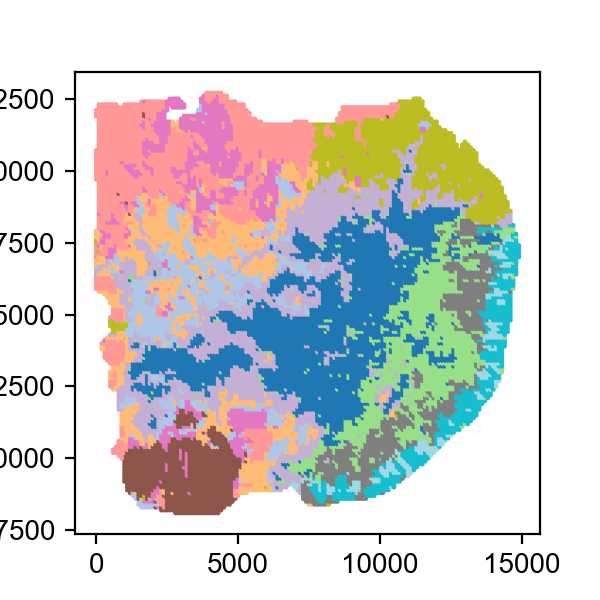

In [118]:
with plt.rc_context({'figure.figsize': (3, 3)}):
    plt.scatter(coords.iloc[:,0], coords.iloc[:,1],
                c = tumor.obs['bayes_clusters'], cmap='tab20', s = 0.5)
    plt.show()

#### Check marker gene expression

Cell-type marker genes (Supplementary Fig 23a):

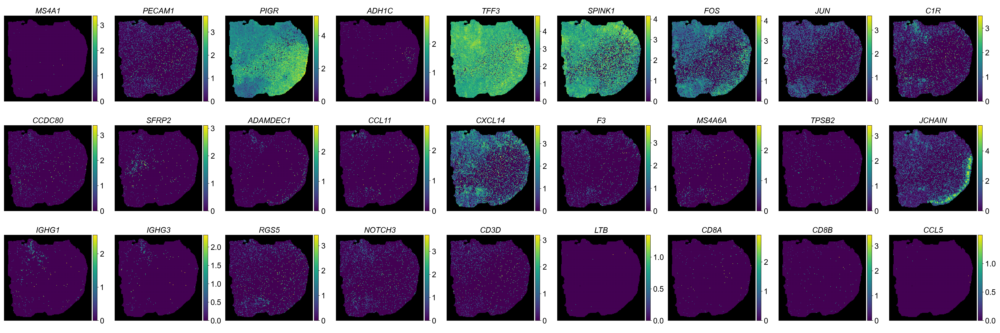

In [119]:
gene_to_plot = ['MS4A1', 'PECAM1', 
                'PIGR', 'ADH1C', 'TFF3', 'SPINK1', 'FOS', 'JUN',
                'C1R', 'CCDC80', 'SFRP2', 'ADAMDEC1', 'CCL11', 'CXCL14', 'F3', 
                'MS4A6A',
                'TPSB2',
                'JCHAIN', 'IGHG1', 'IGHG3',
                'RGS5', 'NOTCH3',
                'CD3D', 'LTB', 'CD8A', 'CD8B', 'CCL5',
               ]
gene_inds = [np.where(tumor.var_names == g)[0][0] for g in gene_to_plot if g in tumor.var_names]
n_gene = len(gene_to_plot)
n_col = 9
n_row = int(np.ceil(n_gene / n_col))
fig, axes = plt.subplots(n_row, n_col, figsize = (4*n_col, 4*n_row))

for i, (ax, ind) in enumerate(zip(axes.flatten(), gene_inds)):
    ax.set_title(f"{gene_to_plot[i]}", **{'fontname': 'Arial', "fontsize": 20, "fontstyle": "italic"})
    p = ax.scatter(coords.iloc[:,0], coords.iloc[:,1], c = tumor.layers['lognorm'][:, ind].toarray(), s = 0.5, marker="s")
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    cax.tick_params(labelsize=20)
    fig.colorbar(p, cax=cax, orientation = 'vertical')
    ax.set_facecolor('black')
    ax.axis('equal')
    ax.set_xticks([])
    ax.set_yticks([])
fig.tight_layout()
plt.savefig(f"geneexp_tumor.png", bbox_inches="tight", dpi=300)
plt.show()

Fibroblast marker genes (Supplementary Fig 24b):

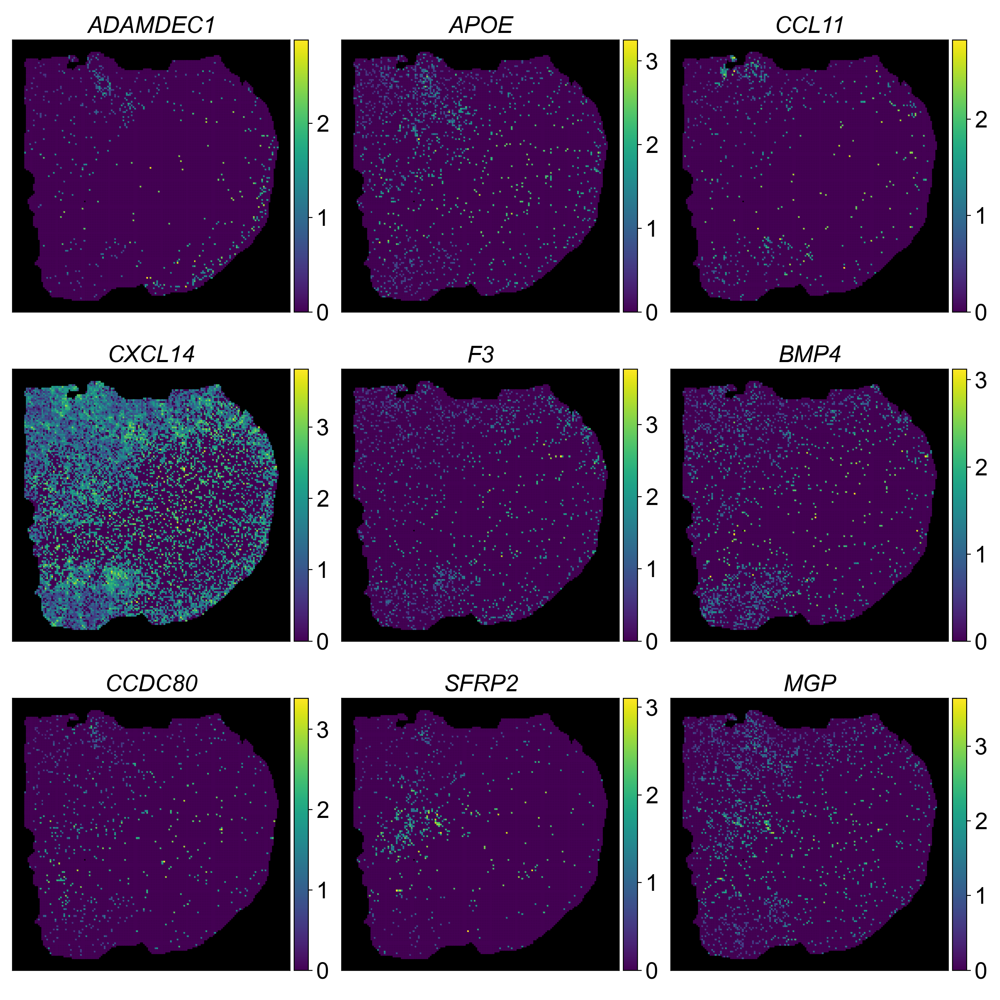

In [120]:
gene_to_plot = ['ADAMDEC1', 'APOE', 'CCL11',
                'CXCL14', 'F3', 'BMP4',
                'CCDC80', 'SFRP2', 'MGP'
]
gene_inds = [np.where(tumor.var_names == g)[0][0] for g in gene_to_plot if g in tumor.var_names]
n_gene = len(gene_to_plot)
n_col = 3
n_row = int(np.ceil(n_gene / n_col))
fig, axes = plt.subplots(n_row, n_col, figsize = (4*n_col, 4*n_row))

for i, (ax, ind) in enumerate(zip(axes.flatten(), gene_inds)):
    ax.set_title(f"{gene_to_plot[i]}", **{'fontname': 'Arial', "fontsize": 20, "fontstyle": "italic"})
    p = ax.scatter(coords.iloc[:,0], coords.iloc[:,1], c = tumor.layers['lognorm'][:, ind].toarray(), s = 0.6, marker="s")
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    cax.tick_params(labelsize=20)
    fig.colorbar(p, cax=cax, orientation = 'vertical')
    ax.set_facecolor('black')
    ax.axis('equal')
    ax.set_xticks([])
    ax.set_yticks([])
fig.tight_layout()
plt.savefig(f"geneexp_tumor_fibroblast.png", bbox_inches="tight", dpi=300)
plt.show()

### Deconvolution

#### Prepare inputs and spatial loss

In [121]:
# read in log_count matrices
# reference count matrix, num_gene x num_celltype
lc_x = pd.read_csv(f"{data_dir}/scref/ref_avg_logcount_nm50.csv", header=0, index_col=0)
cell_types = lc_x.columns

gene_selected = pd.Series(list(set(tumor.var_names) & set(lc_x.index)))
gene_idx = [np.where(tumor.var_names == g)[0][0] for g in gene_selected]
x = torch.tensor(lc_x.loc[gene_selected,:].values).float()

# spatial counts
y = torch.tensor(tumor.layers['raw'][:, gene_idx].toarray().T).float()
y = torch.log1p(y)

print(x.shape, y.shape)

torch.Size([646, 16]) torch.Size([646, 18125])


In [122]:
# calculate spatial weight matrix
weights = SpatialWeightMatrix()
weights.calc_weights_knn(coords, k=8)

# scale the spatial weight matrix by transcriptional similarity
weights.scale_by_expr(y)

# convert spatial weight into loss
spatial_loss = SpatialLoss('icar', weights, scale_weights=0.99)

Number of spots: 18125. Average number of neighbors per spot:  7.93.
Number of spots: 18125. Average number of neighbors per spot:  7.93.


#### Run deconvolution

In [123]:
torch.manual_seed(20230701)

deconv_configs = {'lr':1e-2, 'tol':1e-5, 'max_epochs':-1, 'verbose':False}
l_sp_list = [0, 1, 3, 10]
deconv_models = []

for l_sp in l_sp_list:
    model = DWLS()
    model.deconv(x, y, spatial_loss=spatial_loss,
                 lambda_spatial_loss=l_sp, **deconv_configs)
    deconv_models.append(model)

p_inf_list = [m.get_props() for m in deconv_models]

=== Time  34.14s. Total epoch 177. Final loss: (total) 0.583. (spatial) 0.000.
=== Time  33.77s. Total epoch 170. Final loss: (total) 0.584. (spatial) 0.001.
=== Time  32.88s. Total epoch 169. Final loss: (total) 0.586. (spatial) 0.002.
=== Time  31.83s. Total epoch 165. Final loss: (total) 0.589. (spatial) 0.004.


#### Save results

In [124]:
# res_dir = "/Users/jysumac/Projects/SpatialDeconv/results/crc_stereo/p19_t/nm50/"
res_dir = "/Users/jbreynier/Desktop/Research/Rabadan_Lab/Spatial_Deconvolution/SpatialDeconv/results/crc_stereo/p19_t/nm50/"
method_names = ['dwls_sp' + str(l_sp) for l_sp in l_sp_list]

for p_inf, name in zip(p_inf_list, method_names):
    # save results
    np.savetxt(res_dir + f"/{name}.txt", p_inf, header=' '.join(cell_types), comments='')

### Visualize results

#### Reload deconvolution results

In [125]:
# data_dir = "/Users/jysumac/Projects/SpatialDeconv/data/crc_stereo/"
# res_dir = "/Users/jysumac/Projects/SpatialDeconv/results/crc_stereo/p19_t/nm50/"
data_dir = "/Users/jbreynier/Desktop/Research/Rabadan_Lab/Spatial_Deconvolution/SpatialDeconv/data/crc_stereo/"
res_dir = "/Users/jbreynier/Desktop/Research/Rabadan_Lab/Spatial_Deconvolution/SpatialDeconv/results/crc_stereo/p19_t/nm50/"
l_sp_list = [0, 1, 3, 10]
method_names = [f"dwls_sp{str(l_sp)}" for l_sp in l_sp_list]
p_inf_list = [np.loadtxt(f"{res_dir}/{name}.txt", skiprows=1) 
              for name in method_names]

In [126]:
tumor = sc.read_h5ad(data_dir + "P19_T.h5ad")
coords = tumor.obs[['x', 'y']] # spatial coordinates, num_spot x 2

sc.pp.filter_genes(tumor, min_cells=10)
tumor.layers['raw'] = tumor.X.copy()

sc.pp.normalize_total(tumor, target_sum=1e4)
sc.pp.log1p(tumor)
tumor.layers['lognorm'] = tumor.X.copy()

cell_types = pd.read_csv(f"{data_dir}/scref/ref_avg_logcount_nm50.csv", 
                         header=0, index_col=0, nrows=0).columns

#### Absolute abundance

Smoother-DWLS with spatial loss (Supplementary Fig 23b):

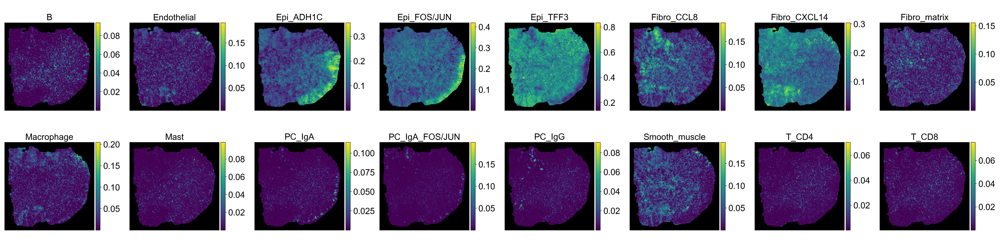

In [127]:
plot_celltype_props_pub(p_inf_list[3], coords, cell_type_names = cell_types, n_col=8, filename="smoother_tumor_celltypeprop_withspatial", s=0.5)

Smoother-DWLS without spatial loss:

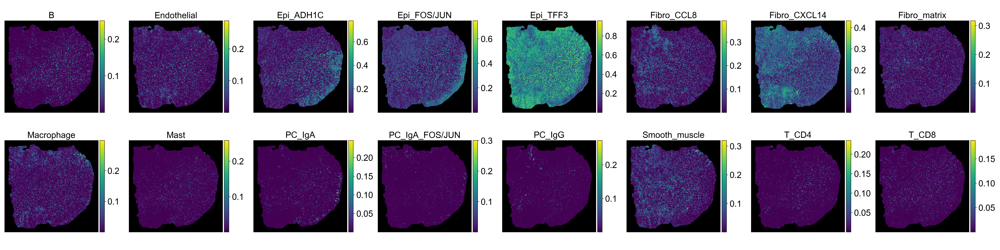

In [128]:
plot_celltype_props_pub(p_inf_list[0], coords, cell_type_names = cell_types, n_col=8, filename="smoother_tumor_celltypeprop_nospatial", s=0.5)

#### Clustering the abundances

In [129]:
method_names = ['DWLS (l=0)', 'DWLS (l=1)', 'DWLS (l=3)', 'DWLS (l=10)']
np.random.seed(20230701)
p, clu_aligned_list = cluster_and_plot_celltype_props(
    p_inf_list, coords, names = method_names, n_col = 4,
    transform = 'pca', n_neighbors = 36, res = 0.3,
    return_clu = True
)

# check number of clusters
[len(clu.unique()) for clu in clu_aligned_list]

[7, 6, 6, 5]

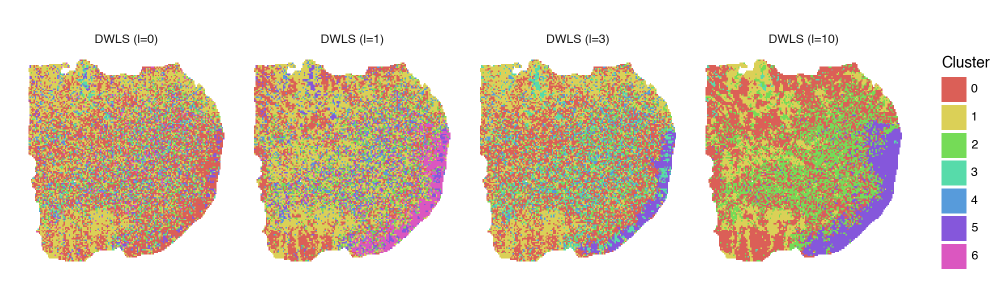

<Figure Size: (1000 x 300)>

In [130]:
p + theme(figure_size=(10,3))

#### Check plasma cell colocalization

In [131]:
name_g = 'IGHG4'
name_ct = 'PC_IgG'
ind_g = np.where(tumor.var_names == name_g)[0][0]
ind_ct = np.where(lc_x.columns == name_ct)[0][0]

print(f'Correlation between {name_ct} and {name_g} expression')

for p_inf, l_sp in zip(p_inf_list, l_sp_list):
    coef = np.corrcoef(p_inf[:,ind_ct], tumor[:, ind_g].X.toarray().squeeze())[0,1]
    print(f"l_sp = {l_sp}, corrcoef = {coef}")

Correlation between PC_IgG and IGHG4 expression
l_sp = 0, corrcoef = 0.2792759394587247
l_sp = 1, corrcoef = 0.311759697648434
l_sp = 3, corrcoef = 0.3400195392191999
l_sp = 10, corrcoef = 0.34516917892177773


In [132]:
name_g = 'JCHAIN'
name_ct = 'PC_IgA'
ind_g = np.where(tumor.var_names == name_g)[0][0]
ind_ct = np.where(lc_x.columns == name_ct)[0][0]

print(f'Correlation between {name_ct} and {name_g} expression')

for p_inf, l_sp in zip(p_inf_list, l_sp_list):
    coef = np.corrcoef(p_inf[:,ind_ct], tumor[:, ind_g].X.toarray().squeeze())[0,1]
    print(f"l_sp = {l_sp}, corrcoef = {coef}")

Correlation between PC_IgA and JCHAIN expression
l_sp = 0, corrcoef = 0.2619686210978093
l_sp = 1, corrcoef = 0.2921872836119161
l_sp = 3, corrcoef = 0.32121738975704794
l_sp = 10, corrcoef = 0.34850510307849353


In [133]:
name_ct1 = 'PC_IgG'
name_ct2 = 'Fibro_CCL8'
name_g = 'ADAMDEC1'

ind_ct1 = np.where(lc_x.columns == name_ct1)[0][0]
ind_ct2 = np.where(lc_x.columns == name_ct2)[0][0]
ind_g = np.where(tumor.var_names == name_g)[0][0]

print(f'Correlation between {name_ct1} and {name_ct2} expression')

for p_inf, l_sp in zip(p_inf_list, l_sp_list):
    coef_ct = np.corrcoef(p_inf[:, ind_ct1], p_inf[:, ind_ct2])[0,1]
    coef_gene = np.corrcoef(p_inf[:,ind_ct1], tumor[:, ind_g].X.toarray().squeeze())[0,1]
    print(f"l_sp = {l_sp}, corr_ct = {coef_ct}, corr_marker = {coef_gene}")

Correlation between PC_IgG and Fibro_CCL8 expression
l_sp = 0, corr_ct = 0.0683385509165026, corr_marker = 0.011880190221927696
l_sp = 1, corr_ct = 0.0954398832004372, corr_marker = 0.012453171446529465
l_sp = 3, corr_ct = 0.1208639070759299, corr_marker = 0.015920311234267733
l_sp = 10, corr_ct = 0.14907567476882863, corr_marker = 0.033500471532282285


In [134]:
name_ct1 = 'PC_IgG'
name_ct2 = 'Epi_TFF3'
name_g = 'TFF3'
name_g = 'SPINK1'

ind_ct1 = np.where(lc_x.columns == name_ct1)[0][0]
ind_ct2 = np.where(lc_x.columns == name_ct2)[0][0]
ind_g = np.where(tumor.var_names == name_g)[0][0]

print(f'Correlation between {name_ct1} and {name_ct2} expression')

for p_inf, l_sp in zip(p_inf_list, l_sp_list):
    coef_ct = np.corrcoef(p_inf[:, ind_ct1], p_inf[:, ind_ct2])[0,1]
    coef_gene = np.corrcoef(p_inf[:,ind_ct1], tumor[:, ind_g].X.toarray().squeeze())[0,1]
    print(f"l_sp = {l_sp}, corr_ct = {coef_ct}, corr_marker = {coef_gene}")

Correlation between PC_IgG and Epi_TFF3 expression
l_sp = 0, corr_ct = -0.09286104619235834, corr_marker = -0.062079047748387454
l_sp = 1, corr_ct = -0.1062627977097152, corr_marker = -0.07897168443683109
l_sp = 3, corr_ct = -0.13175865489865832, corr_marker = -0.10317455973552081
l_sp = 10, corr_ct = -0.19989364940926257, corr_marker = -0.12911989596341775


### Compare with CARD results

#### Load CARD results

In [135]:
# res_dir = "/Users/jysumac/Projects/SpatialDeconv/results/crc_stereo/p19_t/"
res_dir = "/Users/jbreynier/Desktop/Research/Rabadan_Lab/Spatial_Deconvolution/SpatialDeconv/results/crc_stereo/p19_t"

method_names_card = ["card_sp0", "card_sp1"]
p_inf_list_card = [np.loadtxt(f"{res_dir}/nm50/{name}.txt", skiprows=1) 
              for name in method_names_card]

CARD with spatial loss (Supplementary Fig 23c):

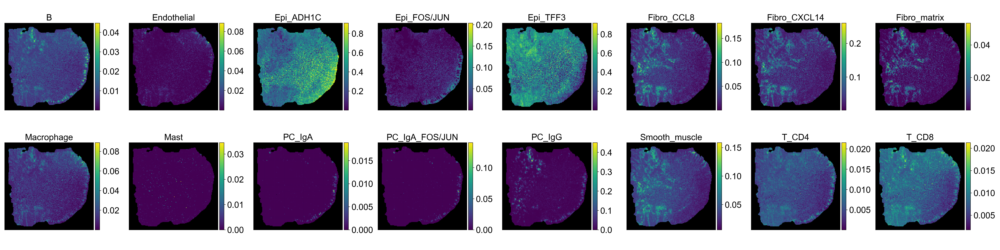

In [136]:
plot_celltype_props_pub(p_inf_list_card[1], coords, cell_types, n_col=8, filename="card_tumor_celltypeprop_withspatial", s=0.5)

#### Clustering the abundances

In [137]:
method_names = ['DWLS (-)', 'DWLS (+ spatial loss)', 'CARD (phi=0)', 'CARD (phi=0.99)']
np.random.seed(20230701)
p, clu_aligned_list = cluster_and_plot_celltype_props(
    [p_inf_list[0], p_inf_list[3]] + p_inf_list_card, 
    coords, names = method_names, n_col = 4,
    transform = 'pca', n_neighbors = 36, res = 0.4,
    return_clu = True
)

# check number of clusters
[len(clu.unique()) for clu in clu_aligned_list]

[9, 7, 8, 7]

Cell-type composition clustering (Figure 5d):

/Users/jbreynier/opt/anaconda3/envs/smoother/lib/python3.10/site-packages/plotnine/scales/scales.py:50: PlotnineWarning: Scale for 'fill' is already present.
Adding another scale for 'fill',
which will replace the existing scale.



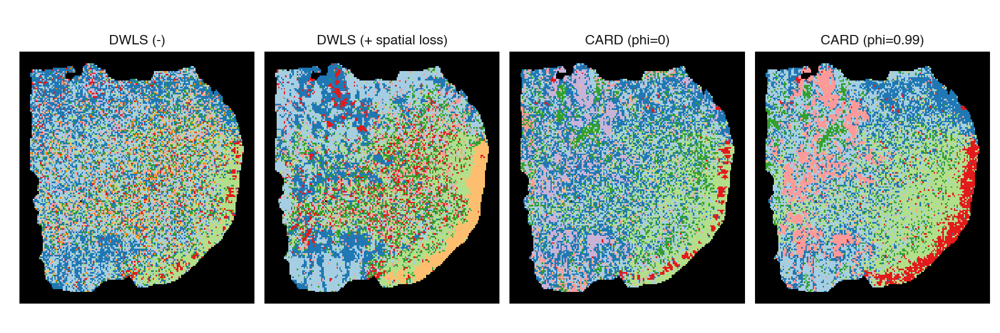

<Figure Size: (900 x 300)>

In [138]:
(
    p + theme(figure_size=(9,3), 
          legend_position='none', 
          panel_background=element_rect(fill = 'black')) + 
    scale_fill_prism('summer') + 
    scale_fill_brewer(type='qual', palette='Paired') 
    # scale_fill_prism('stained_glass')
)

### Check plasma cell colocalization

Smoother-DWLS fibroblast deconvolution results (Supplementary Fig 24a):

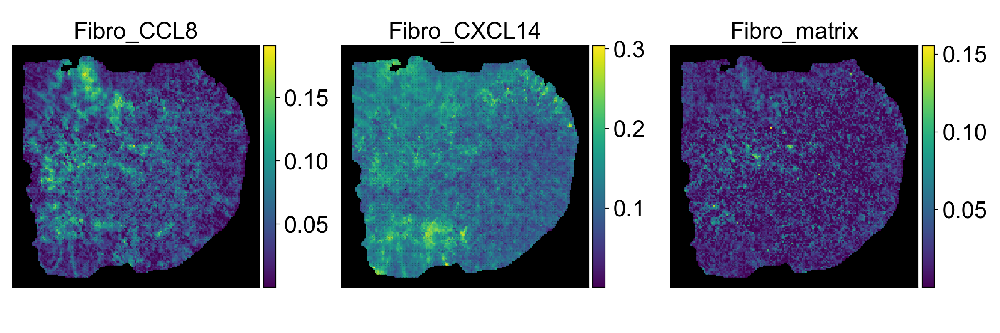

In [139]:
ct_to_plot = ['Fibro_CCL8', 'Fibro_CXCL14', 'Fibro_matrix']
ct_ind = [np.where(cell_types == ct)[0][0] for ct in ct_to_plot]

plot_celltype_props_pub(p_inf_list[3][:, ct_ind], coords, ct_to_plot, filename="smoother_tumor_celltypeprop_withspatial_fibro", n_col=3, s=0.5)

CARD fibroblast deconvolution results (Supplementary Fig 24a):

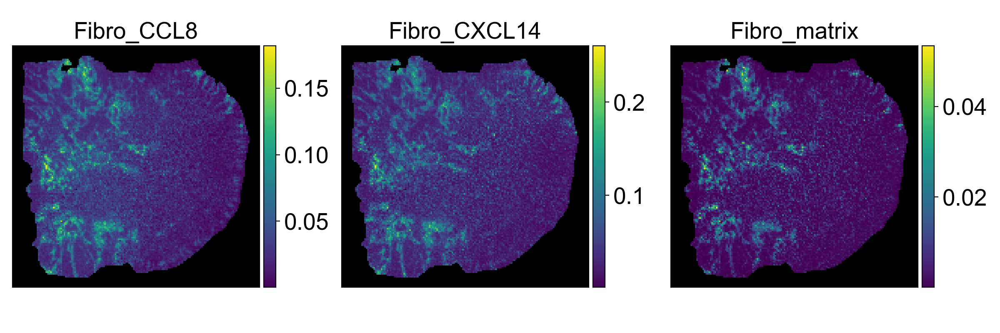

In [140]:
ct_to_plot = ['Fibro_CCL8', 'Fibro_CXCL14', 'Fibro_matrix']
ct_ind = [np.where(cell_types == ct)[0][0] for ct in ct_to_plot]

plot_celltype_props_pub(p_inf_list_card[1][:, ct_ind], coords, ct_to_plot, filename="card_tumor_celltypeprop_withspatial_fibro", n_col=3, s=0.5)

#### Visualize PC localization patterns

In [141]:
def plot_plasma_subtypes(p_inf, coords, p_cutoff = 0.0):
    ct_to_plot = ['PC_IgG', 'PC_IgA', 'PC_IgA_FOS/JUN']
    ct_ind = [np.where(cell_types == ct)[0][0] for ct in ct_to_plot]

    df = pd.DataFrame(coords.values, columns = ['x', 'y'])
    df['IgG'] = p_inf[:, ct_ind[0]]
    # df['IgA'] = p_inf[:, ct_ind[1]] + p_inf_list[3][:, ct_ind[2]]
    df['IgA'] = p_inf[:, ct_ind[1]]
    df['IgA_FOS/JUN'] = p_inf[:, ct_ind[2]]
    df = pd.melt(df, id_vars=['x', 'y'], var_name = 'Cell type', value_name = 'Props')

    df['Props'][df['Props'] < p_cutoff] = 0
    df['Props'] = df.groupby('Cell type')['Props'].transform(lambda x: x / (x.max() +1e-8))
    
    p = (
        ggplot(df, aes(x = 'x', y = 'y',
                           fill = 'Cell type', alpha = 'Props')) + 
            geom_tile() + 
            scale_alpha_continuous(range = [0, 1]) + 
            scale_fill_manual(values = {'IgG': 'red', 'IgA': 'blue', 'IgA_FOS/JUN': 'yellow'}) + 
            guides(alpha = None) + 
            theme_void() + 
            theme(panel_background = element_rect(color = 'black', size=1, fill='black'))
    )
    return p

/var/folders/ww/wp54dp116f919zl6ld381gmr0000gn/T/ipykernel_25717/76764979.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


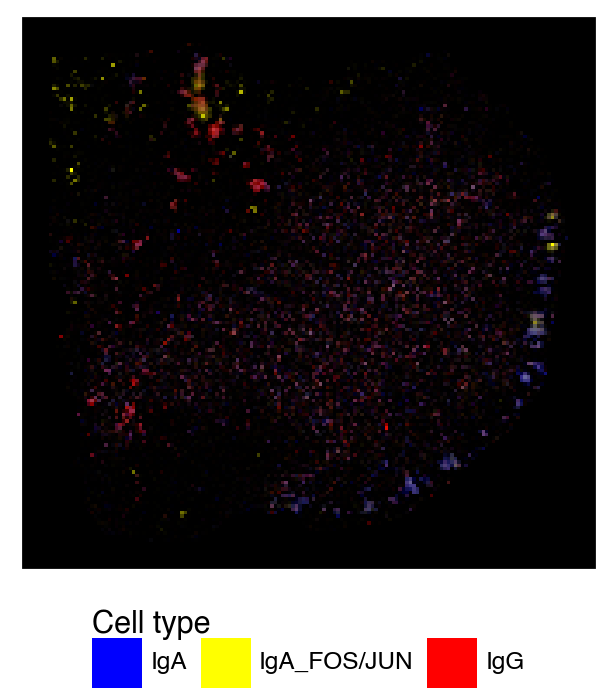

<Figure Size: (300 x 350)>

In [142]:
plot_plasma_subtypes(p_inf_list[3], coords) + theme(figure_size=(3,3.5), legend_position='bottom')

/var/folders/ww/wp54dp116f919zl6ld381gmr0000gn/T/ipykernel_25717/76764979.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


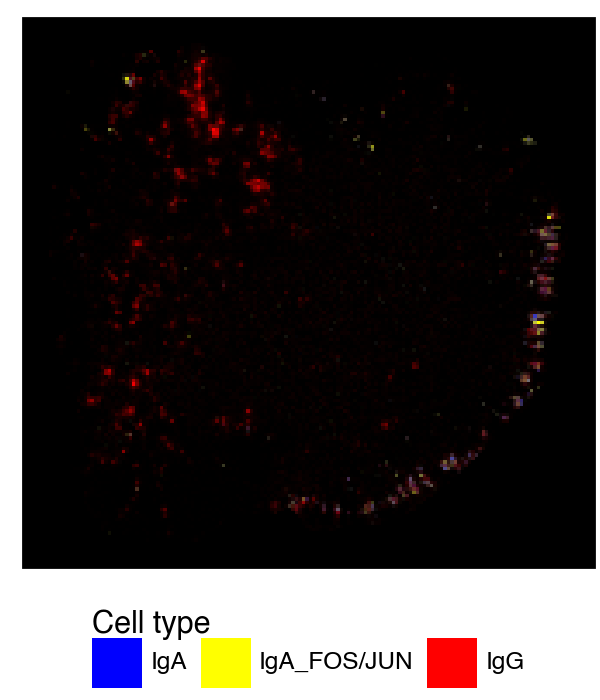

<Figure Size: (300 x 350)>

In [143]:
plot_plasma_subtypes(p_inf_list_card[1], coords) + theme(figure_size=(3,3.5), legend_position='bottom')

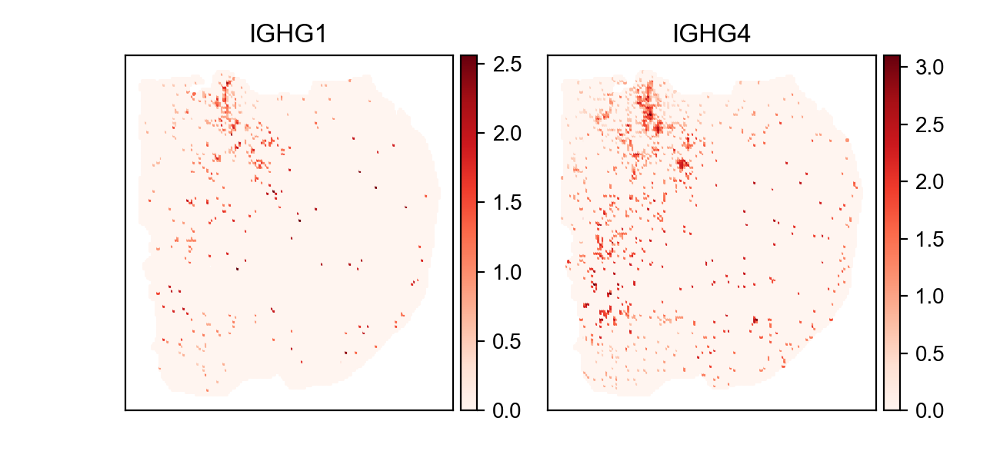

In [144]:
gene_to_plot = ['IGHG1', 'IGHG4']
gene_inds = [np.where(tumor.var_names == g)[0][0] for g in gene_to_plot if g in tumor.var_names]
n_gene = len(gene_to_plot)
fig, axes = plt.subplots(1, n_gene, figsize = (3.25*n_gene, 3))

for i, ind in enumerate(gene_inds):
    axes[i].set_title(f"{gene_to_plot[i]}")
    p = axes[i].scatter(coords.iloc[:,0], coords.iloc[:,1], 
                        c = tumor[:, ind].X.toarray(), cmap = 'Reds',
                        s = 0.5, marker = 's')
    
    divider = make_axes_locatable(axes[i])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(p, cax=cax, orientation = 'vertical')

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])

plt.show()

Generate color gradients for publication plots:

In [145]:
from matplotlib.colors import LinearSegmentedColormap

def create_custom_colormap(min_color, max_color):
    cmap_dict = {
        'red': ((0.0, min_color[0], min_color[0]), (1.0, max_color[0], max_color[0])),
        'green': ((0.0, min_color[1], min_color[1]), (1.0, max_color[1], max_color[1])),
        'blue': ((0.0, min_color[2], min_color[2]), (1.0, max_color[2], max_color[2])),
    }
    return LinearSegmentedColormap('custom_colormap', cmap_dict)

In [146]:
# For #1f77b4
# #15537d
dark_blue = (21,83,125)
dark_blue = tuple([col / 255 for col in dark_blue])
# #e8f1f7
light_blue = (232,241,247)
light_blue = tuple([col / 255 for col in light_blue])
blue_cmap = create_custom_colormap(light_blue, dark_blue)
# gradient = plt.imshow([[i for i in range(100)]], cmap=blue_cmap, aspect='auto')
# plt.colorbar(gradient)
# plt.title('Blue Gradient')
# plt.show()

In [147]:
# For #d62728
# #951b1c
dark_red = (149,27,28)
dark_red = tuple([col / 255 for col in dark_red])
# #e8f1f7
light_red = (250,233,233)
light_red = tuple([col / 255 for col in light_red])
red_cmap = create_custom_colormap(light_red, dark_red)
# gradient = plt.imshow([[i for i in range(100)]], cmap=red_cmap, aspect='auto')
# plt.colorbar(gradient)
# plt.title('Red Gradient')
# plt.show()

In [148]:
# For #ff7f0e
# #fae9e9
dark_orange = (178,88,9)
dark_orange = tuple([col / 255 for col in dark_orange])
# #fff2e6
light_orange = (255,242,230)
light_orange = tuple([col / 255 for col in light_orange])
orange_cmap = create_custom_colormap(light_orange, dark_orange)
# gradient = plt.imshow([[i for i in range(100)]], cmap=orange_cmap, aspect='auto')
# plt.colorbar(gradient)
# plt.title('Orange Gradient')
# plt.show()

For cell types:

In [149]:
df_smoother_results = pd.DataFrame(p_inf_list[3], columns=cell_types)
df_smoother_results = pd.concat([df_smoother_results, tumor.obs[["x", "y"]].reset_index(drop=True)], axis=1)
df_smoother_results

,B,Endothelial,Epi_ADH1C,Epi_FOS/JUN,Epi_TFF3,Fibro_CCL8,Fibro_CXCL14,Fibro_matrix,Macrophage,Mast,PC_IgA,PC_IgA_FOS/JUN,PC_IgG,Smooth_muscle,T_CD4,T_CD8,x,y
0,0.000122,0.000022,0.061255,0.186230,0.550666,0.035121,0.109657,0.023414,0.021820,0.000586,0.000135,0.000074,0.000140,0.010198,0.000216,0.000345,0.0,35900.0
1,0.000828,0.000241,0.093933,0.146359,0.618258,0.000123,0.105086,0.027134,0.000055,0.001080,0.002721,0.002168,0.000882,0.000444,0.000623,0.000065,0.0,36000.0
2,0.002834,0.026778,0.128223,0.163833,0.531546,0.001216,0.110435,0.011558,0.016668,0.001873,0.001674,0.000450,0.000029,0.000548,0.001037,0.001298,0.0,36100.0
3,0.000178,0.000340,0.140620,0.092792,0.599421,0.000546,0.110637,0.031760,0.000089,0.000186,0.000128,0.012716,0.000227,0.010028,0.000209,0.000125,0.0,36200.0
4,0.000677,0.000725,0.059629,0.066509,0.686890,0.036183,0.115698,0.009626,0.006994,0.000168,0.000257,0.000728,0.000424,0.013680,0.000535,0.001276,0.0,36300.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18120,0.000668,0.000103,0.086120,0.170331,0.580602,0.000087,0.127971,0.001100,0.025441,0.000573,0.000231,0.001266,0.000339,0.004559,0.000376,0.000231,9900.0,41800.0
18121,0.000673,0.000926,0.072176,0.131694,0.598888,0.008553,0.131478,0.017614,0.029876,0.001379,0.000446,0.000802,0.000775,0.003701,0.000449,0.000569,9900.0,41900.0
18122,0.000448,0.020919,0.057116,0.144241,0.562367,0.032610,0.135081,0.011349,0.016046,0.000445,0.001346,0.000146,0.000721,0.016264,0.000333,0.000568,9900.0,42000.0
18123,0.000129,0.005881,0.075973,0.144075,0.602421,0.013466,0.125231,0.017013,0.006078,0.000346,0.000674,0.000492,0.001158,0.005988,0.001049,0.000027,9900.0,42100.0


PC_IgG abundance (Figure 5e):

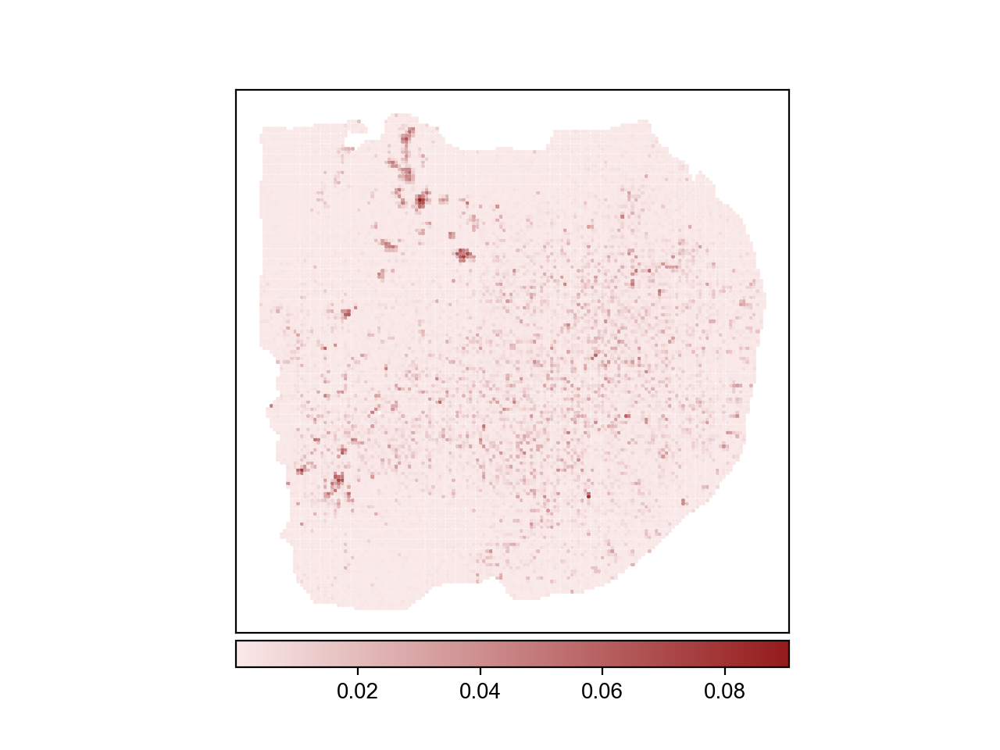

In [150]:
ax = plt.subplot()
p = ax.scatter(df_smoother_results["x"], df_smoother_results["y"], 
    c = df_smoother_results["PC_IgG"], cmap = red_cmap,
    s = 0.6, marker = 's')
ax.axis('equal')
divider = make_axes_locatable(ax)
cax = divider.append_axes('bottom', size='5%', pad=0.05)
fig.colorbar(p, cax=cax, orientation = 'horizontal')
ax.set_xticks([])
ax.set_yticks([])
plt.savefig("igg_celltype_red2.pdf")
plt.show()

PC_FOS/JUN abundance (Figure 5e):

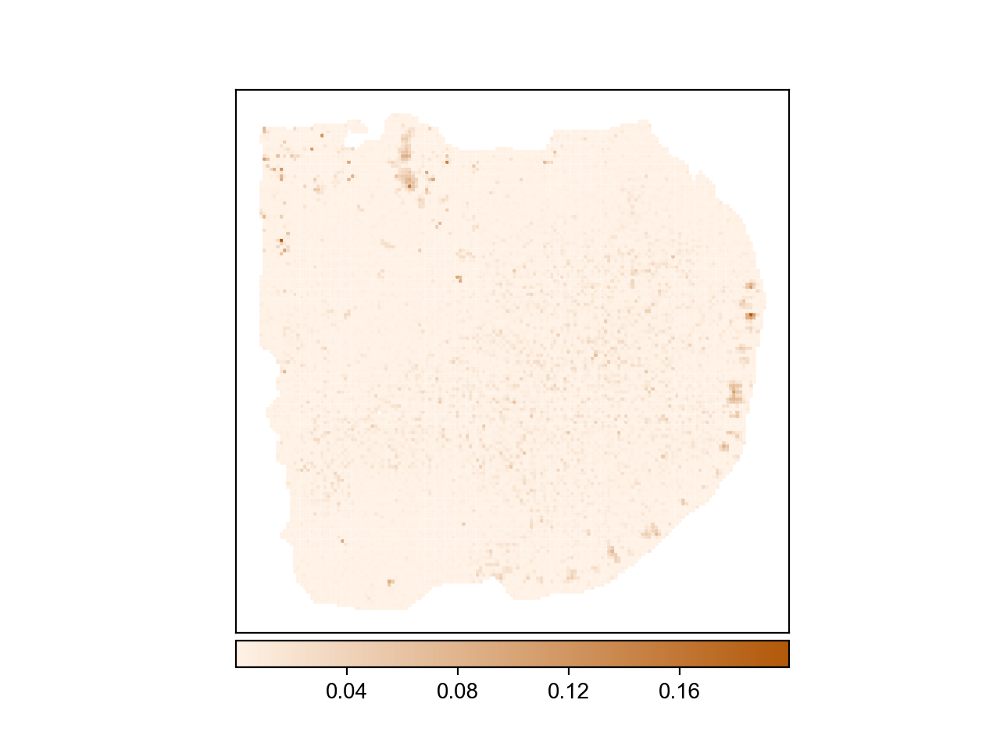

In [151]:
ax = plt.subplot()
p = ax.scatter(df_smoother_results["x"], df_smoother_results["y"], 
    c = df_smoother_results["PC_IgA_FOS/JUN"], cmap = orange_cmap,
    s = 0.6, marker = 's')
ax.axis('equal')
divider = make_axes_locatable(ax)
cax = divider.append_axes('bottom', size='5%', pad=0.05)
fig.colorbar(p, cax=cax, orientation = 'horizontal', ticks = [0.04, 0.08, 0.12, 0.16])
ax.set_xticks([])
ax.set_yticks([])
plt.savefig("igfos_celltype_orange2.pdf")
plt.show()

PC_IgA abundance (Figure 5e):

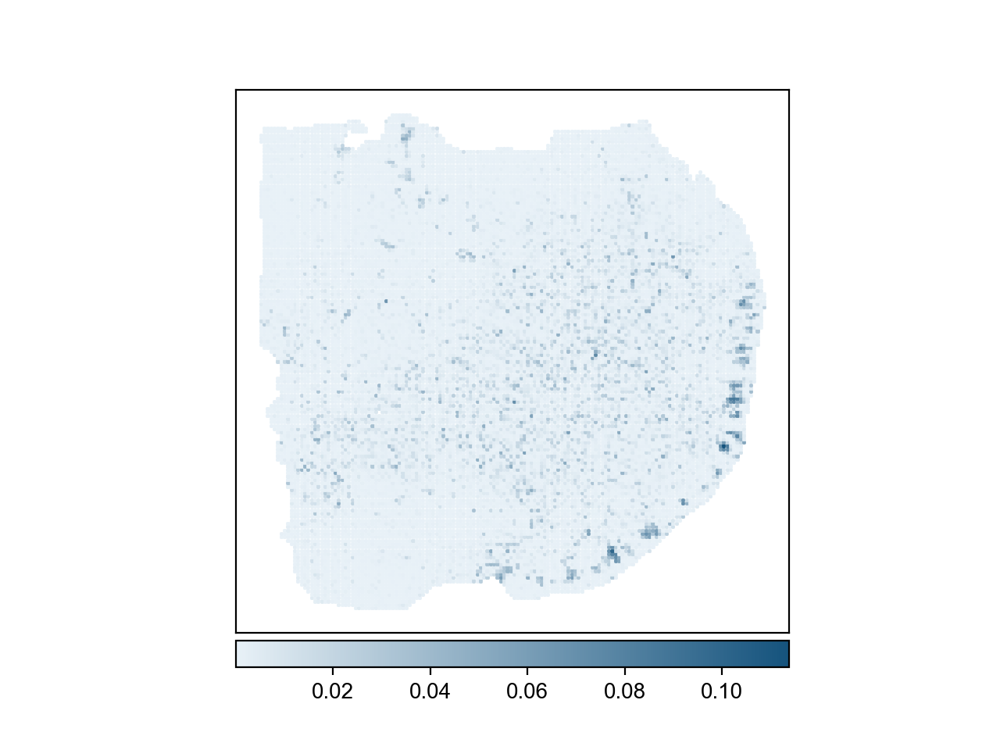

In [152]:
ax = plt.subplot()
p = ax.scatter(df_smoother_results["x"], df_smoother_results["y"], 
    c = df_smoother_results["PC_IgA"], cmap = blue_cmap,
    s = 0.6, marker = 's')
ax.axis('equal')
divider = make_axes_locatable(ax)
cax = divider.append_axes('bottom', size='5%', pad=0.05)
fig.colorbar(p, cax=cax, orientation = 'horizontal')
ax.set_xticks([])
ax.set_yticks([])
plt.savefig("iga_celltype_blue2.pdf")
plt.show()

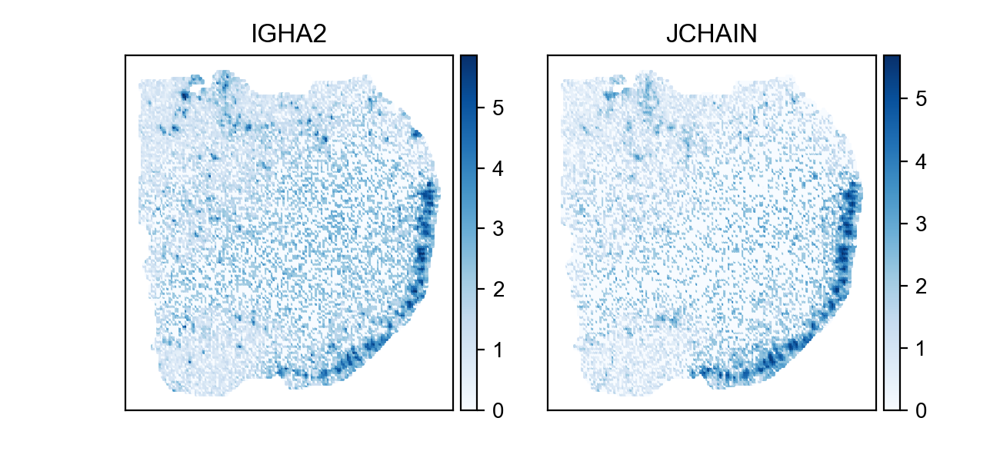

In [153]:
gene_to_plot = ['IGHA2', 'JCHAIN']
gene_inds = [np.where(tumor.var_names == g)[0][0] for g in gene_to_plot if g in tumor.var_names]
n_gene = len(gene_to_plot)
fig, axes = plt.subplots(1, n_gene, figsize = (3.25*n_gene, 3))

for i, ind in enumerate(gene_inds):
    axes[i].set_title(f"{gene_to_plot[i]}")
    p = axes[i].scatter(coords.iloc[:,0], coords.iloc[:,1], 
                        c = tumor[:, ind].X.toarray(), cmap = 'Blues',
                        s = 0.5, marker = 's')
    
    divider = make_axes_locatable(axes[i])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    fig.colorbar(p, cax=cax, orientation = 'vertical')

for ax in axes.flatten():
    ax.set_xticks([])
    ax.set_yticks([])

plt.show()

### TME differences associated with the two plasma populations

#### Select PC spots by abundance ratio

In [154]:
# use DWLS (l=10)
p_inf = p_inf_list[3].copy()

# remove noisy spots
p_inf[p_inf < 0.01] = 0

# extract PC abundances
prop_igg = p_inf[:, np.where(cell_types == 'PC_IgG')[0][0]]
prop_iga = p_inf[:, np.where(cell_types == 'PC_IgA')[0][0]]
#prop_iga += p_inf[:, np.where(cell_types == 'PC_IgA_FOS/JUN')[0][0]]

print(f"Number of spots: IgG+: {(prop_igg > 0).sum()}. IgA+: {(prop_iga > 0).sum()}.")

Number of spots: IgG+: 1528. IgA+: 1783.


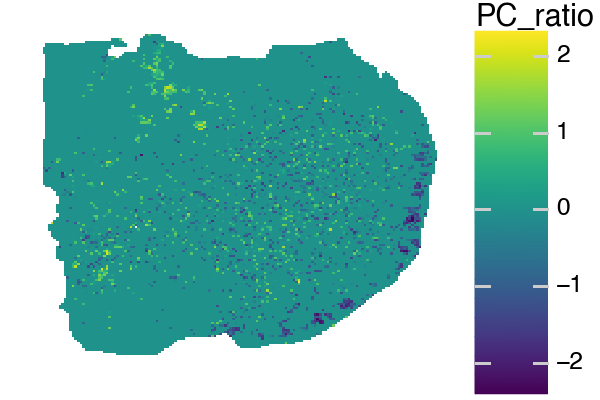

<Figure Size: (300 x 200)>

In [155]:
# Add small proportions for stability
tumor.obs['PC_ratio'] = np.log((prop_igg + 1e-2)/ (prop_iga + 1e-2))

(
    ggplot(tumor.obs) + 
        geom_tile(aes(x = 'x', y = 'y', fill = 'PC_ratio')) + 
        theme_void() + 
        theme(figure_size=(3,2))
)

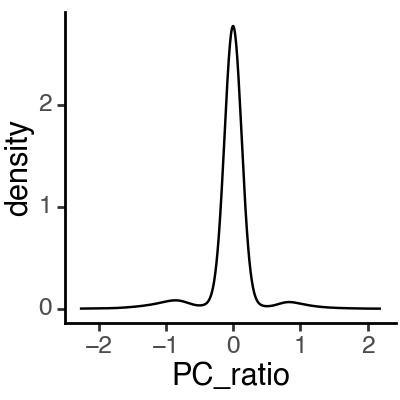

<Figure Size: (200 x 200)>

In [156]:
(
    ggplot(tumor.obs) + 
        geom_density(aes(x = 'PC_ratio')) + 
        theme_classic() + 
        theme(figure_size=(2,2))
)

/var/folders/ww/wp54dp116f919zl6ld381gmr0000gn/T/ipykernel_25717/877763334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/var/folders/ww/wp54dp116f919zl6ld381gmr0000gn/T/ipykernel_25717/877763334.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/var/folders/ww/wp54dp116f919zl6ld381gmr0000gn/T/ipykernel_25717/877763334.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


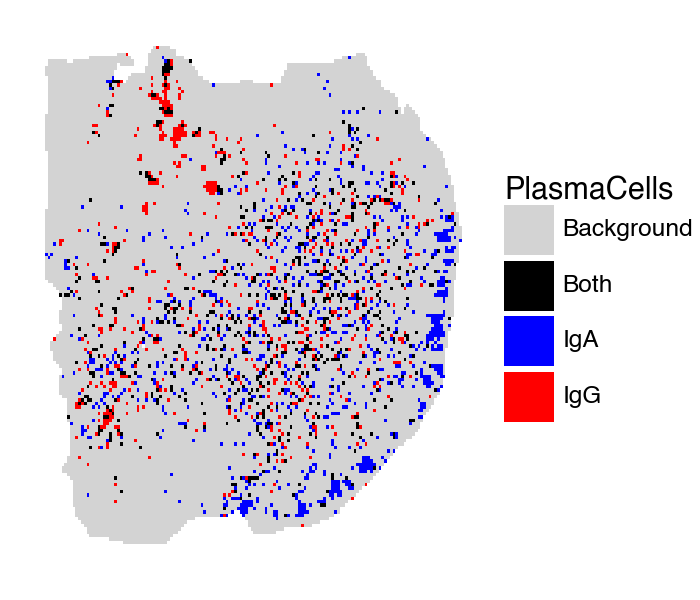

<Figure Size: (350 x 300)>

In [157]:
tumor.obs['PlasmaCells'] = 'Background'
tumor.obs['PlasmaCells'][(prop_igg > 0) & (prop_iga > 0)] = 'Both'
tumor.obs['PlasmaCells'][tumor.obs['PC_ratio'] > 0.5] = 'IgG'
tumor.obs['PlasmaCells'][tumor.obs['PC_ratio'] < -0.5] = 'IgA'

(
    ggplot(tumor.obs) + 
        geom_tile(aes(x = 'x', y = 'y', fill = 'PlasmaCells')) + 
        scale_fill_manual(
            values={'Background':'lightgray', 'Both':'black', 'IgG':'red', 'IgA':'blue'}
        ) + 
        theme_void() + 
        theme(figure_size=(3.5,3))

)

#### Select PC spots by neighbors (too many spots and overlaps)

In [158]:
weights = SpatialWeightMatrix()
weights.calc_weights_knn(coords, k=4)
swm = weights.swm + torch.sparse_coo_tensor(
    torch.arange(coords.shape[0]).repeat(2,1),
    torch.ones(coords.shape[0]),
    weights.swm.shape
)

is_pc_igg = prop_igg > 0
is_pc_iga = prop_iga > 0

is_pc_igg = (swm @ (torch.tensor(is_pc_igg) * 1.0)).bool().numpy()
is_pc_iga = (swm @ (torch.tensor(is_pc_iga) * 1.0)).bool().numpy()
print(f"Number of spots within the community: IgG+: {is_pc_igg.sum()}. IgA+: {is_pc_iga.sum()}.")

Number of spots: 18125. Average number of neighbors per spot:  3.97.
Number of spots within the community: IgG+: 5334. IgA+: 6017.


/var/folders/ww/wp54dp116f919zl6ld381gmr0000gn/T/ipykernel_25717/3622608272.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/var/folders/ww/wp54dp116f919zl6ld381gmr0000gn/T/ipykernel_25717/3622608272.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/var/folders/ww/wp54dp116f919zl6ld381gmr0000gn/T/ipykernel_25717/3622608272.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


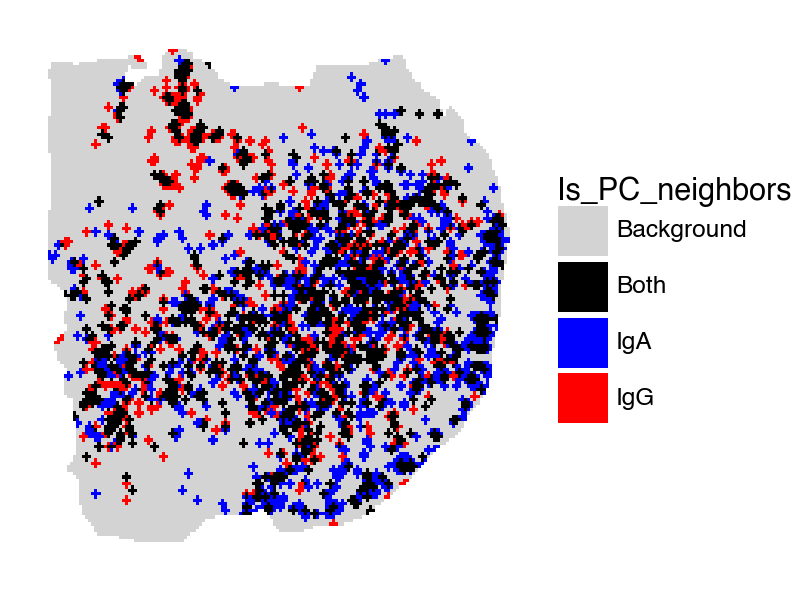

<Figure Size: (400 x 300)>

In [159]:
tumor.obs['Is_PC_neighbors'] = 'Background'
tumor.obs['Is_PC_neighbors'][is_pc_igg] = 'IgG'
tumor.obs['Is_PC_neighbors'][is_pc_iga] = 'IgA'
tumor.obs['Is_PC_neighbors'][is_pc_igg & is_pc_iga] = 'Both'

(
    ggplot(tumor.obs) + 
        geom_tile(aes(x = 'x', y = 'y', fill = 'Is_PC_neighbors')) + 
        scale_fill_manual(
            values={'Background':'lightgray', 'Both':'black', 'IgG':'red', 'IgA':'blue'}
        ) + 
        theme_void() + 
        theme(figure_size=(4,3))

)

#### Visualize cell type compositions

In [160]:
ct_total_igg = p_inf[tumor.obs['PlasmaCells'] == 'IgG', :]
ct_total_igg = ct_total_igg / ct_total_igg.sum(1, keepdims = True)
ct_total_iga = p_inf[tumor.obs['PlasmaCells'] == 'IgA', :]
ct_total_iga = ct_total_iga / ct_total_iga.sum(1, keepdims = True)

df_ct = pd.DataFrame(
    np.concatenate([ct_total_igg, ct_total_iga], 0),
    columns = cell_types
)
df_ct['Type'] = np.append(np.repeat('IgG', ct_total_igg.shape[0]), 
                               np.repeat('IgA', ct_total_iga.shape[0]))
df_ct = df_ct.melt(id_vars=['Type'], var_name='Cell type', value_name='Props')

In [161]:
# Wilcoxon rank-sum test
from scipy.stats import ranksums

def pvalue_to_asterisks(pvalue):
    if pvalue < 0.001:
        return '***'
    elif pvalue < 0.01:
        return '**'
    elif pvalue < 0.05:
        return '*'
    else:
        return 'ns'

df_pval = pd.DataFrame({'Cell type': cell_types, 'pval': 0})

for i, ct in enumerate(cell_types):
    _, df_pval['pval'][i] = ranksums(df_ct[(df_ct['Cell type'] == ct) & (df_ct['Type'] == 'IgG')]['Props'],
              df_ct[(df_ct['Cell type'] == ct) & (df_ct['Type'] == 'IgA')]['Props']
             )

df_pval['pval_adj'] = df_pval['pval'] * len(cell_types)
df_pval['symbol'] = df_pval['pval_adj'].apply(pvalue_to_asterisks)

/var/folders/ww/wp54dp116f919zl6ld381gmr0000gn/T/ipykernel_25717/299893556.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Colocalization of cell types with PC_IgA and PC_IgG (Figure 5h):

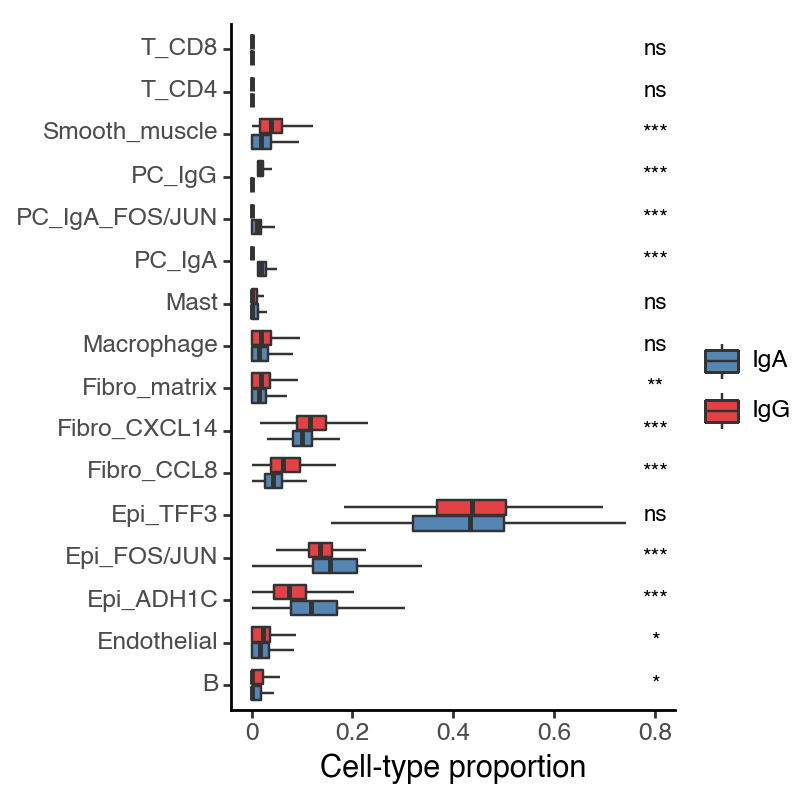

<Figure Size: (400 x 400)>

In [162]:
(
    ggplot(df_ct) + 
        geom_boxplot(
                     aes(x = 'Cell type', y = 'Props',
                      fill = 'Type'), outlier_shape = 'none') + 
        geom_text(data=df_pval,
                  mapping=aes(x='Cell type', y='0.8',
                             label='symbol'),
                     size=8) +
        theme_classic() + 
        scale_fill_manual(values={'IgA': '#5586B3', 'IgG': '#E44144'}) + 
        labs(x = '', fill = '', y = 'Cell-type proportion') + 
        coord_flip() + 
        theme(figure_size = (4,4))
)

For publication:

In [163]:
df_ct["Type"] = df_ct["Type"].replace({"IgG": "PC_IgG", "IgA": "PC_IgA"})
list_celltype = list(df_ct["Cell type"].unique())
list_celltype.reverse()
(
    ggplot(df_ct) + 
        geom_boxplot(
                     aes(x = 'Cell type', y = 'Props',
                      fill = 'Type'), outlier_shape = 'none', color="black", size=0.4) + 
        geom_text(data=df_pval,
                  mapping=aes(x='Cell type', y='0.8',
                             label='symbol'),
                     size=8) +
        theme_classic() + 
        scale_fill_manual(values={'PC_IgA': '#1f77b4', 'PC_IgG': '#d62728'}) + 
        labs(x = '', fill = '', y = 'Cell-type proportion') + 
        scale_x_discrete(limits=list_celltype) +
        coord_flip() + 
        theme(figure_size = (6,4),
            axis_line_x = element_line(color="black"),
            axis_line_y = element_line(color="black"),
            axis_ticks_major = element_line(color="black"),
            text = element_text(color="black")

        )
).save(filename="boxplot_neighbors_wide.pdf")

/Users/jbreynier/opt/anaconda3/envs/smoother/lib/python3.10/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 6 x 4 in image.
/Users/jbreynier/opt/anaconda3/envs/smoother/lib/python3.10/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: boxplot_neighbors_wide.pdf


#### Calculate differentially expressed genes

In [164]:
sc.tl.rank_genes_groups(
    tumor, 'PlasmaCells', method='wilcoxon',
    use_raw=False, layer='lognorm', groups = ['IgG'], reference = 'IgA'
)

In [165]:
deg = sc.get.rank_genes_groups_df(
    tumor, group = None,
    pval_cutoff = 0.01
)
deg = deg[deg.logfoldchanges.abs() > 0.5]

In [166]:
deg.sort_values('logfoldchanges', ascending=False).iloc[:20,:]

,names,scores,logfoldchanges,pvals,pvals_adj
48,IGHG3,4.564263,6.923468,5.012529e-06,2.249061e-03
12,IGHG1,6.075931,4.889030,1.232703e-09,1.680820e-06
3,IGHG4,9.875857,3.827094,5.297790e-23,2.528282e-19
0,IGLC2,12.558412,1.691928,3.574373e-36,3.411620e-32
10,IGLC3,6.452623,1.658194,1.099306e-10,1.748752e-07
43,CTSK,4.643682,1.364277,3.422542e-06,1.689674e-03
21,MMP2,5.396416,1.350615,6.798541e-08,5.725571e-05
7,IGFBP5,7.032815,1.348009,2.024085e-12,4.139833e-09
20,BX322234.1,5.402017,1.282552,6.589575e-08,5.717754e-05
17,POSTN,5.641675,1.224575,1.684035e-08,1.785950e-05


In [167]:
deg.sort_values('logfoldchanges', ascending=True).iloc[:20,:]

,names,scores,logfoldchanges,pvals,pvals_adj
92,JCHAIN,-13.753753,-2.270258,4.835476e-43,1.384590e-38
83,PLA2G2A,-5.570058,-1.940616,2.546548e-08,2.604209e-05
91,IGHA2,-12.659586,-1.746979,9.902007e-37,1.417670e-32
79,PLAC8,-5.158408,-1.597745,2.490591e-07,1.828605e-04
86,ZG16,-6.686030,-1.582658,2.293062e-11,4.377303e-08
78,CKB,-4.465939,-1.136706,7.971844e-06,3.126929e-03
87,FABP1,-7.205657,-1.094885,5.776484e-13,1.272337e-09
76,SIL1,-4.275442,-0.898042,1.907583e-05,6.638217e-03
75,MUC1,-4.242785,-0.709033,2.207636e-05,7.350402e-03
85,AC243967.1,-6.407262,-0.600404,1.481562e-10,2.232792e-07


#### GO analysis

In [168]:
df_go_igg = sc.queries.enrich(
    deg[deg['logfoldchanges'] > 0]['names'].to_list(), 
    org="hsapiens", 
    gprofiler_kwargs = {'sources': ['GO:BP']}
)

df_go_igg

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0030198,extracellular matrix organization,1.178146e-13,True,"""A process that is carried out at the cellular...",320,44,15,21010,0.340909,0.046875,query_1,"[GO:0043062, GO:0045229]"
1,GO:BP,GO:0043062,extracellular structure organization,1.234278e-13,True,"""A process that is carried out at the cellular...",321,44,15,21010,0.340909,0.046729,query_1,[GO:0016043]
2,GO:BP,GO:0045229,external encapsulating structure organization,1.354076e-13,True,"""A process that is carried out at the cellular...",323,44,15,21010,0.340909,0.046440,query_1,[GO:0016043]
3,GO:BP,GO:0007155,cell adhesion,6.107167e-10,True,"""The attachment of a cell, either to another c...",1504,44,21,21010,0.477273,0.013963,query_1,[GO:0009987]
4,GO:BP,GO:0030199,collagen fibril organization,1.472822e-09,True,"""Any process that determines the size and arra...",64,44,8,21010,0.181818,0.125000,query_1,"[GO:0030198, GO:0097435]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78,GO:BP,GO:0009611,response to wounding,3.032997e-02,True,"""Any process that results in a change in state...",548,44,8,21010,0.181818,0.014599,query_1,[GO:0006950]
79,GO:BP,GO:0051093,negative regulation of developmental process,3.118053e-02,True,"""Any process that stops, prevents or reduces t...",923,44,10,21010,0.227273,0.010834,query_1,"[GO:0032502, GO:0048519, GO:0050793]"
80,GO:BP,GO:0051240,positive regulation of multicellular organisma...,3.558406e-02,True,"""Any process that activates or increases the f...",1629,44,13,21010,0.295455,0.007980,query_1,"[GO:0032501, GO:0048518, GO:0051239]"
81,GO:BP,GO:0042060,wound healing,4.650877e-02,True,"""The series of events that restore integrity t...",419,44,7,21010,0.159091,0.016706,query_1,[GO:0009611]


In [169]:
df_go_iga = sc.queries.enrich(
    deg[deg['logfoldchanges'] < 0]['names'].to_list(), 
    org="hsapiens", 
    gprofiler_kwargs = {'sources': ['GO:BP']}
)

df_go_iga

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0042742,defense response to bacterium,0.000209,True,"""Reactions triggered in response to the presen...",314,10,5,21010,0.5,0.015924,query_1,"[GO:0009617, GO:0098542]"
1,GO:BP,GO:0001895,retina homeostasis,0.008222,True,"""A tissue homeostatic process involved in the ...",82,10,3,21010,0.3,0.036585,query_1,[GO:0001894]
2,GO:BP,GO:0060267,positive regulation of respiratory burst,0.008936,True,"""Any process that increases the rate frequency...",9,10,2,21010,0.2,0.222222,query_1,"[GO:0009893, GO:0045730, GO:0060263]"
3,GO:BP,GO:0009617,response to bacterium,0.011596,True,"""Any process that results in a change in state...",710,10,5,21010,0.5,0.007042,query_1,[GO:0051707]
4,GO:BP,GO:0048871,multicellular organismal-level homeostasis,0.022798,True,"""Any process involved in the maintenance of an...",816,10,5,21010,0.5,0.006127,query_1,"[GO:0032501, GO:0042592]"
5,GO:BP,GO:0060263,regulation of respiratory burst,0.037890,True,"""Any process that modulates the rate frequency...",18,10,2,21010,0.2,0.111111,query_1,"[GO:0019222, GO:0045730]"


Pathways enriched in the PC_IgG spots (Figure 5g):

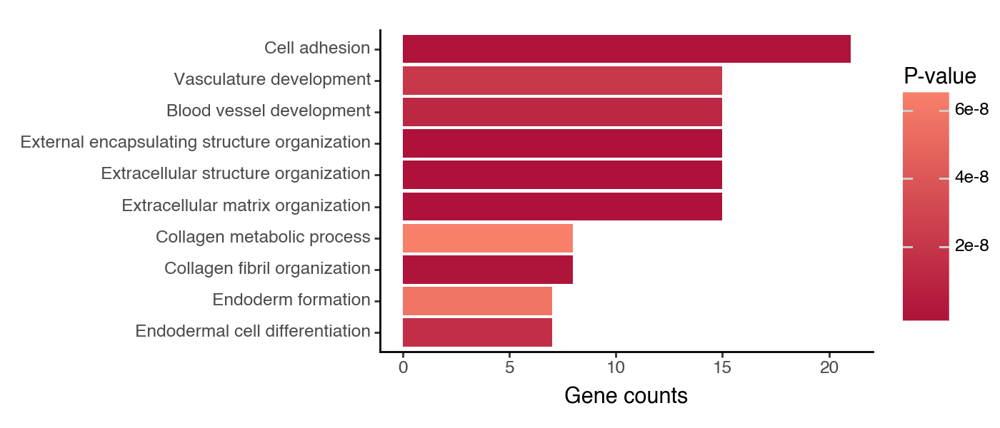

<Figure Size: (700 x 300)>

In [170]:
df_go_vis = df_go_igg.iloc[:10,:].sort_values('intersection_size', ascending=True)
df_go_vis['name'] = df_go_vis['name'].str.capitalize()
df_go_vis['name'] = df_go_vis['name'].astype('category').cat.reorder_categories(df_go_vis['name'])


(
    ggplot(df_go_vis, aes(y = 'intersection_size', x = 'name', fill = 'p_value')) +
        geom_bar(stat='identity') + 
        labs(y = 'Gene counts', x = '', fill = 'P-value') +
        scale_fill_gradient(low = "#AE123A", high = "#F8806A") + 
        coord_flip() +
        theme_classic() + 
        theme(figure_size=(7,3))
)

Pathways enriched in the PC_IgA spots (Figure 5g):

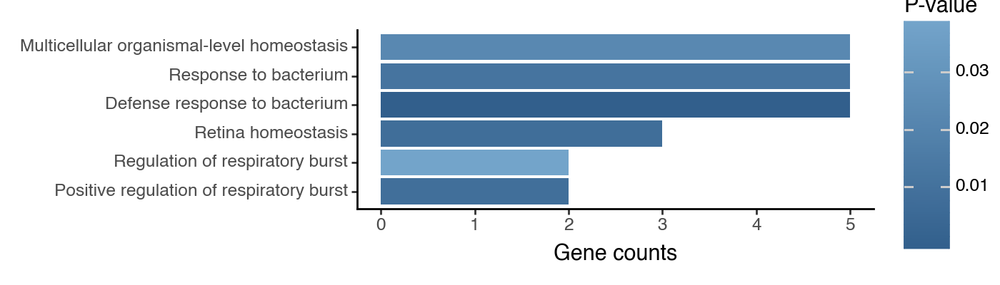

<Figure Size: (700 x 200)>

In [171]:
df_go_vis = df_go_iga.iloc[:10,:].sort_values('intersection_size', ascending=True)
df_go_vis['name'] = df_go_vis['name'].str.capitalize()
df_go_vis['name'] = df_go_vis['name'].astype('category').cat.reorder_categories(df_go_vis['name'])


(
    ggplot(df_go_vis, aes(y = 'intersection_size', x = 'name', fill = 'p_value')) +
        geom_bar(stat='identity') + 
        labs(y = 'Gene counts', x = '', fill = 'P-value') +
        scale_fill_gradient(high = "#73A4CA", low = "#325F8C") + 
        coord_flip() +
        theme_classic() + 
        theme(figure_size=(7,2))
)

For publication:

In [172]:
go_to_keep = ["extracellular matrix organization", "endodermal cell differentiation",
"cell adhesion", "collagen fibril organization", "blood vessel development", "positive regulation of B cell activation",
"phagocytosis, recognition"]

df_go_vis = df_go_igg.loc[df_go_igg["name"].isin(go_to_keep),:]
df_go_vis["neg_p_value"] = - df_go_vis["p_value"]
df_go_vis = df_go_vis.sort_values(by=['intersection_size', "neg_p_value"], ascending=True)
df_go_vis['name'] = df_go_vis['name'].str.capitalize()
df_go_vis['name'] = df_go_vis['name'].str.replace("b cell", "B cell")
df_go_vis['name'] = df_go_vis['name'].astype('category').cat.reorder_categories(df_go_vis['name'])

(
    ggplot(df_go_vis, aes(y = 'intersection_size', x = 'name', fill = 'p_value')) +
        geom_bar(stat='identity') + 
        labs(y = 'Gene counts', x = '', fill = 'P-value') +
        scale_fill_gradient(low = "#951b1c", high = "#e26768") + 
        coord_flip() +
        theme_classic() + 
        theme(figure_size=(7,3))
).save(filename="barplot_igg.pdf")

/var/folders/ww/wp54dp116f919zl6ld381gmr0000gn/T/ipykernel_25717/3074031904.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/jbreynier/opt/anaconda3/envs/smoother/lib/python3.10/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 7 x 3 in image.
/Users/jbreynier/opt/anaconda3/envs/smoother/lib/python3.10/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: barplot_igg.pdf


In [173]:
go_to_keep = ["defense response to bacterium", "positive regulation of respiratory burst", "multicellular organismal-level homeostasis"]

df_go_vis = df_go_iga.loc[df_go_iga["name"].isin(go_to_keep),:].sort_values('intersection_size', ascending=True)
df_go_vis["neg_p_value"] = - df_go_vis["p_value"]
df_go_vis = df_go_vis.sort_values(by=['intersection_size', "neg_p_value"], ascending=True)
df_go_vis['name'] = df_go_vis['name'].str.capitalize()
df_go_vis['name'] = df_go_vis['name'].astype('category').cat.reorder_categories(df_go_vis['name'])

(
    ggplot(df_go_vis, aes(y = 'intersection_size', x = 'name', fill = 'p_value')) +
        geom_bar(stat='identity') + 
        labs(y = 'Gene counts', x = '', fill = 'P-value') +
        scale_fill_gradient(high = "#629fca", low = "#15537d") + 
        coord_flip() +
        theme_classic() + 
        theme(figure_size=(7,3))
).save(filename="barplot_iga.pdf")

/Users/jbreynier/opt/anaconda3/envs/smoother/lib/python3.10/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 7 x 3 in image.
/Users/jbreynier/opt/anaconda3/envs/smoother/lib/python3.10/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: barplot_iga.pdf


### BCR diversity

In [174]:
tumor.obs["bayes_clusters_str"] = tumor.obs["bayes_clusters"].astype("str")
tumor.obs.loc[tumor.obs["bayes_clusters_str"].isin(["12.0", "11.0"]) & (tumor.obs["PlasmaCells"] == "IgA"), "functional_sectioning"] = "IgA_mucosa"
tumor.obs.loc[tumor.obs["bayes_clusters_str"].isin(["8.0"]) & (tumor.obs["PlasmaCells"] == "IgG"), "functional_sectioning"] = "IgG_lesion"
tumor.obs.functional_sectioning.value_counts()

functional_sectioning
IgA_mucosa    239
IgG_lesion    156
Name: count, dtype: int64

In [175]:
## Just for setting color on heatmap
sc.pp.pca(tumor)
sc.pp.neighbors(tumor)
sc.tl.umap(tumor)
ax = sc.pl.umap(tumor, color='functional_sectioning', palette={"IgA_mucosa": '#1f77b4', "IgG_lesion": '#d62728'}, show=False)
plt.close()

/Users/jbreynier/opt/anaconda3/envs/smoother/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored


BCR gene expression heatmap for PC_IgA spots in the mucosa and PC_IgG spots in the lesion (Figure 5f):

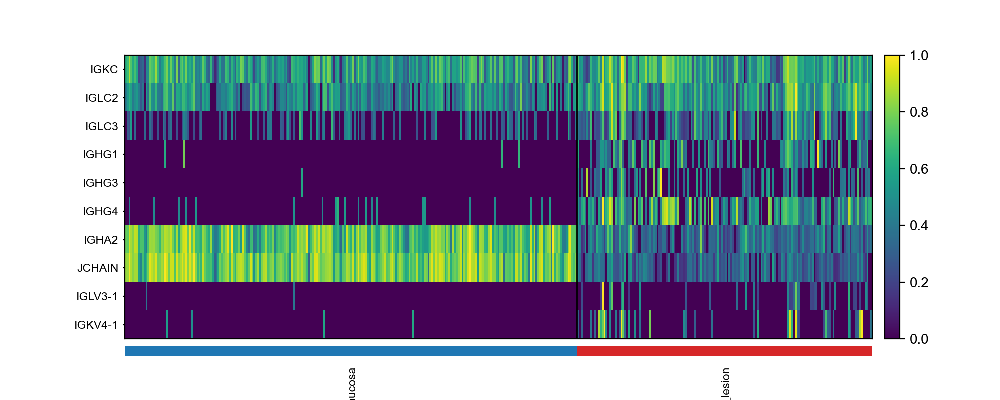

In [176]:
sc.pl.heatmap(tumor[tumor.obs[~tumor.obs["functional_sectioning"].isna()].index, :], ["IGKC", "IGLC2", "IGLC3", "IGHG1", "IGHG3", "IGHG4", "IGHA2", "JCHAIN", "IGLV3-1", "IGKV4-1"], groupby='functional_sectioning',
        standard_scale="var", save="BCR_gene_exp_redo.pdf", figsize=(10, 4), layer="lognorm", 
        swap_axes=True)

In [177]:
sc.tl.rank_genes_groups(
    tumor, 'functional_sectioning', method='wilcoxon',
    use_raw=False, layer='lognorm', groups = ['IgG_lesion'], reference = 'IgA_mucosa'
)
deg = sc.get.rank_genes_groups_df(
    tumor, group = None,
    pval_cutoff = 0.05
)
# deg = deg[deg.logfoldchanges.abs() > 0.5]
deg = deg.sort_values('logfoldchanges', ascending=False)
deg.to_csv("check_diffexp_igglesion_igamucosa.csv", index=False)
deg[deg.names.str.startswith(("IGH", "IGK", "IGL"))]

,names,scores,logfoldchanges,pvals,pvals_adj
154,IGHG3,7.343890,6.709493,2.074731e-13,3.211234e-11
60,IGHG1,9.202401,5.113593,3.500383e-20,1.184134e-17
744,IGLV3-1,3.732348,4.952770,1.897032e-04,6.656816e-03
7,IGHG4,12.233808,4.195385,2.050958e-34,3.090902e-31
516,IGKV4-1,4.329614,4.175475,1.493711e-05,7.399813e-04
119,IGLC3,8.045283,2.178658,8.604613e-16,1.711003e-13
230,IGLC2,5.878899,1.054411,4.130049e-09,4.363831e-07
1354,IGHA2,-15.175059,-3.471080,5.173078e-52,2.468765e-48


## Deconvolute the patient 19 normal tissue

### Load spatial data

In [178]:
# data_dir = "/Users/jysumac/Projects/SpatialDeconv/data/crc_stereo/"
data_dir = "/Users/jbreynier/Desktop/Research/Rabadan_Lab/Spatial_Deconvolution/SpatialDeconv/data/crc_stereo/"
normal = sc.read_h5ad(data_dir + "P19_NT.h5ad")
coords = normal.obs[['x', 'y']] # spatial coordinates, num_spot x 2

sc.pp.filter_genes(normal, min_cells=10)
normal.layers['raw'] = normal.X.copy()

sc.pp.normalize_total(normal, target_sum=1e4)
sc.pp.log1p(normal)
normal.layers['lognorm'] = normal.X.copy()

Bayescluster results:

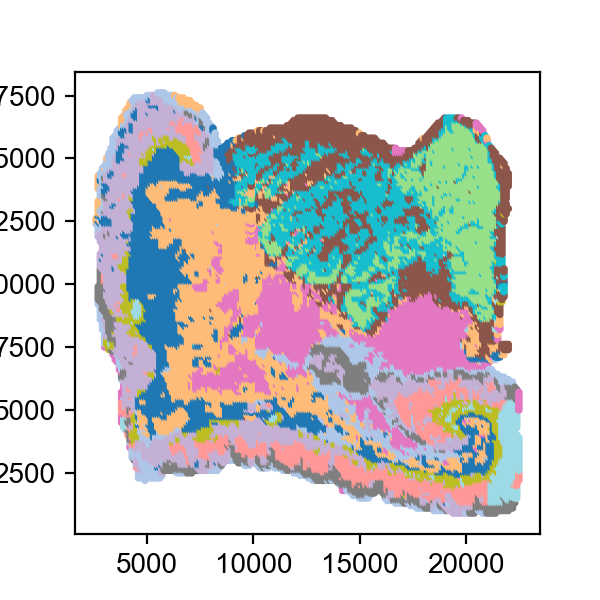

In [179]:
with plt.rc_context({'figure.figsize': (3, 3)}):
    plt.scatter(coords.iloc[:,0], coords.iloc[:,1],
                c = normal.obs['bayes_clusters'], cmap='tab20', s = 3)
    plt.show()

#### Check marker gene expression

Cell-type marker genes (Supplementary Fig 25d):

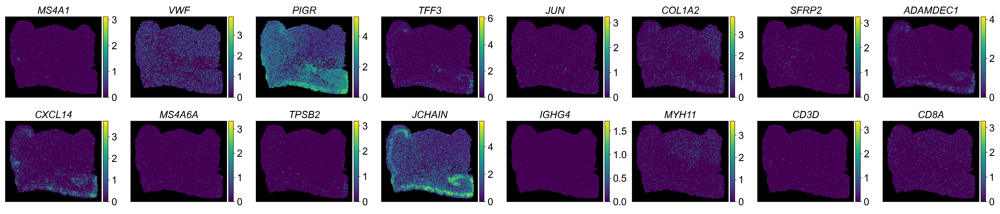

In [180]:
plt.rcParams["font.family"] = "Arial"
gene_to_plot = ['MS4A1', 'VWF',
            'PIGR', 'TFF3', 'JUN',
                'COL1A2', 'SFRP2', 'ADAMDEC1', 'CXCL14',
                'MS4A6A',
                'TPSB2',
                'JCHAIN', 'IGHG4',
                'MYH11', 
                'CD3D', 'CD8A', 
                ]

gene_to_plot = [g for g in gene_to_plot if g in normal.var_names]
gene_inds = [np.where(normal.var_names == g)[0][0] for g in gene_to_plot]

n_gene = len(gene_to_plot)
n_col = 8
n_row = int(np.ceil(n_gene / 8))
fig, axes = plt.subplots(n_row, 8, figsize = (3.5*n_col, 3*n_row))

for i, (ax, ind) in enumerate(zip(axes.flatten(), gene_inds)):
    ax.set_title(f"{gene_to_plot[i]}", **{'fontname': 'Arial', "fontsize": 20, "fontstyle": "italic"})
    p = ax.scatter(coords.iloc[:,0], coords.iloc[:,1], c = normal.layers['lognorm'][:, ind].toarray(), s = 0.5, marker="s")
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    cax.tick_params(labelsize=20)
    fig.colorbar(p, cax=cax, orientation = 'vertical')
    ax.set_facecolor('black')
    ax.axis('equal')
    ax.set_xticks([])
    ax.set_yticks([])
fig.tight_layout()
plt.savefig(f"geneexp_normal.png", bbox_inches="tight", dpi=300)
plt.show()

### Deconvolution

#### Prepare inputs and spatial loss

In [181]:
# read in log_count matrices
# reference count matrix, num_gene x num_celltype
lc_x = pd.read_csv(f"{data_dir}/scref/ref_avg_logcount_nm50.csv", header=0, index_col=0)
cell_types = lc_x.columns

gene_selected = pd.Series(list(set(normal.var_names) & set(lc_x.index)))
gene_idx = [np.where(normal.var_names == g)[0][0] for g in gene_selected]
x = torch.tensor(lc_x.loc[gene_selected,:].values).float()

# spatial counts
y = torch.tensor(normal.layers['raw'][:, gene_idx].toarray().T).float()
y = torch.log1p(y)

print(x.shape, y.shape)

torch.Size([663, 16]) torch.Size([663, 27080])


In [182]:
# calculate spatial weight matrix
weights = SpatialWeightMatrix()
weights.calc_weights_knn(coords, k=8)

# scale the spatial weight matrix by transcriptional similarity
weights.scale_by_expr(y)

# convert spatial weight into loss
spatial_loss = SpatialLoss('icar', weights, scale_weights=0.99)

Number of spots: 27080. Average number of neighbors per spot:  7.94.
Number of spots: 27080. Average number of neighbors per spot:  7.95.


#### Run deconvolution

In [183]:
torch.manual_seed(20220718)

deconv_configs = {'lr':1e-2, 'tol':1e-5, 'max_epochs':-1, 'verbose':False}
l_sp_list = [0, 1, 3, 10]
deconv_models = []

for l_sp in l_sp_list:
    model = DWLS()
    model.deconv(x, y, spatial_loss=spatial_loss,
                 lambda_spatial_loss=l_sp, **deconv_configs)
    deconv_models.append(model)

p_inf_list = [m.get_props() for m in deconv_models]

=== Time  44.55s. Total epoch 120. Final loss: (total) 0.416. (spatial) 0.000.
=== Time  43.54s. Total epoch 119. Final loss: (total) 0.417. (spatial) 0.000.
=== Time  50.66s. Total epoch 120. Final loss: (total) 0.417. (spatial) 0.001.
=== Time  39.39s. Total epoch 117. Final loss: (total) 0.418. (spatial) 0.001.


#### Save results

In [184]:
# res_dir = "/Users/jysumac/Projects/SpatialDeconv/results/crc_stereo/p19_nt/nm50/"
res_dir = "/Users/jbreynier/Desktop/Research/Rabadan_Lab/Spatial_Deconvolution/SpatialDeconv/results/crc_stereo/p19_nt/nm50"
method_names = ['dwls_sp' + str(l_sp) for l_sp in l_sp_list]

for p_inf, name in zip(p_inf_list, method_names):
    # save results
    np.savetxt(res_dir + f"/{name}.txt", p_inf, header=' '.join(cell_types), comments='')

### Visualize results

#### Reload deconvolution results

In [185]:
# data_dir = "/Users/jysumac/Projects/SpatialDeconv/data/crc_stereo/"
# res_dir = "/Users/jysumac/Projects/SpatialDeconv/results/crc_stereo/p19_nt/nm50/"
data_dir = "/Users/jbreynier/Desktop/Research/Rabadan_Lab/Spatial_Deconvolution/SpatialDeconv/data/crc_stereo/"
res_dir = "/Users/jbreynier/Desktop/Research/Rabadan_Lab/Spatial_Deconvolution/SpatialDeconv/results/crc_stereo/p19_nt/nm50/"

normal = sc.read_h5ad(data_dir + "P19_NT.h5ad")
coords = normal.obs[['x', 'y']] # spatial coordinates, num_spot x 2

sc.pp.filter_genes(normal, min_cells=10)
normal.layers['raw'] = normal.X.copy()

sc.pp.normalize_total(normal, target_sum=1e4)
sc.pp.log1p(normal)
normal.layers['lognorm'] = normal.X.copy()

cell_types = pd.read_csv(f"{data_dir}/scref/ref_avg_logcount_nm50.csv", 
                         header=0, index_col=0, nrows=0).columns

l_sp_list = [0, 1, 3, 10]
method_names = [f"dwls_sp{str(l_sp)}" for l_sp in l_sp_list]
p_inf_list = [np.loadtxt(f"{res_dir}/{name}.txt", skiprows=1) 
              for name in method_names]

#### Absolute abundance

Smoother-DWLS with spatial loss (Supplementary Fig 25c):

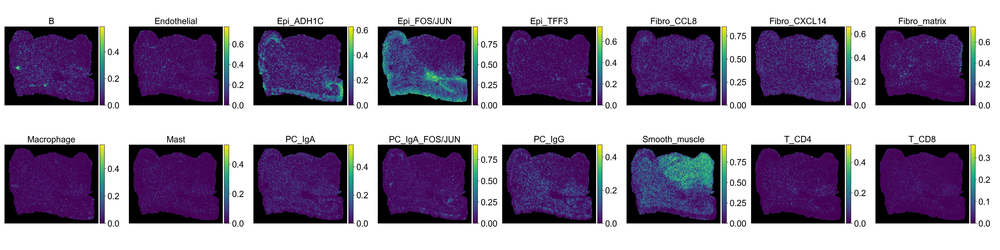

In [186]:
plot_celltype_props_pub(p_inf_list[3], coords, cell_type_names = cell_types, n_col=8, filename="smoother_normal_celltypeprop", s=0.5)

#### Clustering the abundances

In [187]:
np.random.seed(20230701)
method_names = ['DWLS (l=0)', 'DWLS (l=1)', 'DWLS (l=3)', 'DWLS (l=10)']
p, clu_aligned_list = cluster_and_plot_celltype_props(
    p_inf_list, coords, names = method_names, n_col = 4,
    transform = 'pca', n_neighbors = 48, res = 0.25,
    return_clu = True
)

# check number of clusters
[len(clu.unique()) for clu in clu_aligned_list]

[10, 8, 8, 6]

Cell-type composition clustering (Supplementary Fig 25b):

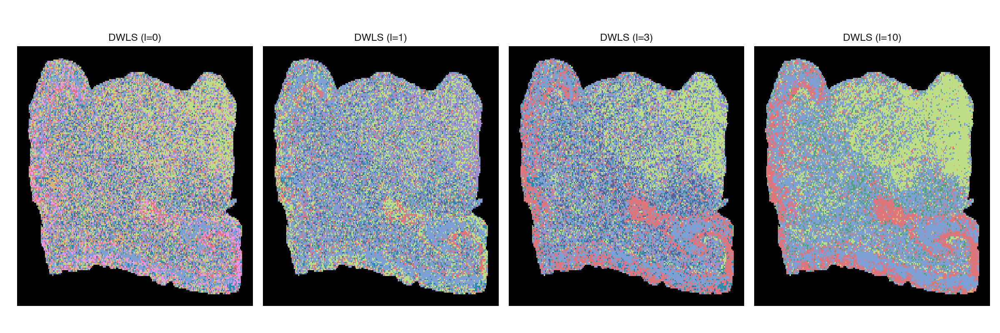

<Figure Size: (1200 x 400)>

In [188]:
p + theme(figure_size=(12,4), 
          legend_position='none', 
          panel_background=element_rect(fill = 'black')) + \
    scale_fill_prism('summer')